# Análise e predição de preços Airbnb em Rio de Janeiro
Este projeto tem como objetivo analisar os dados de preços do Airbnb na cidade do Rio de Janeiro e desenvolver um modelo preditivo para estimar os preços dos imóveis com base em suas características.

### 1. Carregamento e análise inicial dos dados

In [57]:
import pandas as pd

In [58]:
df = pd.read_csv('listings.csv')

In [59]:
df.head()

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,821198084644106078,https://www.airbnb.com/rooms/821198084644106078,20250926170004,2025-09-27,city scrape,Bright and Peaceful Leblon Loft,Welcome! Come relax in our bright and stylish ...,Beautiful tree lined street just 3 blocks from...,https://a0.muscache.com/pictures/hosting/Hosti...,84350716,...,4.94,4.99,4.85,NaN,f,1,1,0,0,2.72
1,821198370698658112,https://www.airbnb.com/rooms/821198370698658112,20250926170004,2025-09-27,city scrape,Copacabana 100% reformado.,Guarantee of a safe and quality stay! <br /><...,"Copacabana, in the part near the neighborhood ...",https://a0.muscache.com/pictures/miso/Hosting-...,4347269,...,NaN,NaN,NaN,NaN,f,2,2,0,0,NaN
2,821200521820144734,https://www.airbnb.com/rooms/821200521820144734,20250926170004,2025-09-26,city scrape,hambiente familia,Relax with the whole family in this quiet acco...,NaN,https://a0.muscache.com/pictures/7485ea61-a28a...,499903412,...,NaN,NaN,NaN,NaN,t,2,1,1,0,NaN
3,821213014263313420,https://www.airbnb.com/rooms/821213014263313420,20250926170004,2025-09-27,previous scrape,Amazing en suite bedroom Leblon,"Kick back and relax in this calm, stylish spac...",NaN,https://a0.muscache.com/pictures/miso/Hosting-...,449763717,...,5.00,5.00,4.67,NaN,f,2,1,1,0,0.10
4,821223043903573522,https://www.airbnb.com/rooms/821223043903573522,20250926170004,2025-09-27,city scrape,Incrível apartamento frente mar,Amazing 1-bedroom apartment facing the sea. Co...,NaN,https://a0.muscache.com/pictures/miso/Hosting-...,25961210,...,5.00,5.00,5.00,NaN,f,1,1,0,0,0.60


In [60]:
df.describe()

,id,scrape_id,host_id,host_listings_count,host_total_listings_count,neighbourhood_group_cleansed,latitude,longitude,accommodates,bathrooms,...,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
count,4.306800e+04,4.306800e+04,4.306800e+04,43057.000000,43057.000000,0.0,43068.000000,43068.000000,43068.000000,38635.000000,...,33881.000000,33881.000000,33881.000000,33880.000000,0.0,43068.000000,43068.00000,43068.000000,43068.000000,33882.000000
mean,8.191760e+17,2.025093e+13,2.371628e+08,12.759017,22.528114,NaN,-22.965776,-43.248402,3.956046,1.486670,...,4.890818,4.883642,4.861770,4.730853,NaN,9.971441,9.08071,0.775750,0.110569,1.202350
std,5.657082e+17,0.000000e+00,2.193633e+08,36.649104,89.983150,NaN,0.035864,0.100678,2.305019,0.969064,...,0.298476,0.307709,0.303583,0.412001,NaN,26.119941,25.97131,2.068128,1.178139,1.306897
min,1.787800e+04,2.025093e+13,3.607000e+03,1.000000,1.000000,NaN,-23.072920,-43.713593,1.000000,0.000000,...,1.000000,1.000000,1.000000,1.000000,NaN,1.000000,0.00000,0.000000,0.000000,0.010000
25%,4.985161e+07,2.025093e+13,3.762061e+07,1.000000,1.000000,NaN,-22.984343,-43.299013,2.000000,1.000000,...,4.890000,4.880000,4.850000,4.670000,NaN,1.000000,1.00000,0.000000,0.000000,0.240000
50%,1.029236e+18,2.025093e+13,1.596793e+08,2.000000,3.000000,NaN,-22.971645,-43.193651,4.000000,1.000000,...,4.980000,4.990000,4.960000,4.830000,NaN,2.000000,1.00000,0.000000,0.000000,0.740000
75%,1.315246e+18,2.025093e+13,4.324447e+08,7.000000,10.000000,NaN,-22.951560,-43.184509,5.000000,2.000000,...,5.000000,5.000000,5.000000,5.000000,NaN,6.000000,4.00000,1.000000,0.000000,1.780000
max,1.518231e+18,2.025093e+13,7.208012e+08,713.000000,2296.000000,NaN,-22.750510,-43.104400,16.000000,16.000000,...,5.000000,5.000000,5.000000,5.000000,NaN,232.000000,232.00000,20.000000,23.000000,15.000000


In [61]:
df.shape

(43068, 79)



### 2. Seleção de colunas relevantes e Feature Engineering, extra: visualização de dados.
- OBS: Devido a grande quantidade de colunas presentes no dataset, foram selecionadas apenas algumas que foram consideradas mais relevantes para análise e predição de preços.

In [62]:
import seaborn as sns
from matplotlib import pyplot as plt
import numpy as np
from sklearn.cluster import KMeans

In [63]:
features_to_use = [
    'accommodates',
    'bedrooms',
    'bathrooms',
    'beds',
    'neighbourhood_cleansed',
    'latitude',
    'longitude',
    'price',
    'review_scores_rating',
    'room_type',
    'host_listings_count',
    'number_of_reviews',
    'minimum_nights',
    'host_is_superhost'
]

In [64]:
# Tratamento do preço para conversão em float
df['price'] = df['price'].str.replace('$', '').str.replace(',', '').astype('float')

In [65]:
len(features_to_use)

14

In [66]:
# Fiquei na dúvida se seria relevante usar a coluna 'property_type', mas devido a variedade de tipos presentes, decidi não utilizá-la. Porém há margem para utilizar essa coluna, caso tenha algum processamento adicional.
print(df['property_type'].nunique())
print(df['property_type'].value_counts())

77
property_type
Entire rental unit             28303
Private room in rental unit     4865
Entire home                     2117
Entire condo                    1795
Private room in home            1487
                               ...  
Shared room in aparthotel          1
Cave                               1
Shared room in dome                1
Shared room in cottage             1
Private room in cabin              1
Name: count, Length: 77, dtype: int64


In [67]:
# Quantidade de bairros
df['neighbourhood_cleansed'].value_counts()

neighbourhood_cleansed
Copacabana                  13277
Barra da Tijuca              3668
Ipanema                      3661
Centro                       2240
Recreio dos Bandeirantes     2161
                            ...  
Turiaçú                         2
Magalhães Bastos                2
Colégio                         2
Gericinó                        1
Caju                            1
Name: count, Length: 152, dtype: int64

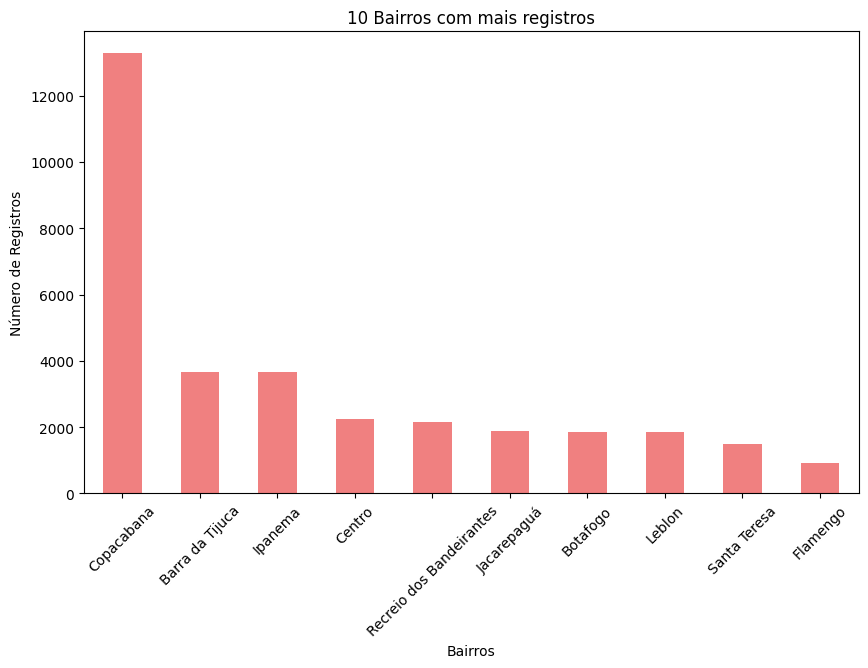

In [68]:
# Gráfico dos 10 bairros com mais registros
top_appearence = df["neighbourhood_cleansed"].value_counts().head(10)

plt.figure(figsize=(10, 6))
top_appearence.plot(kind='bar', color='lightcoral')

plt.title("10 Bairros com mais registros")
plt.xlabel("Bairros")
plt.ylabel("Número de Registros")
plt.xticks(rotation=45)
plt.show()

In [69]:
# Média geral de preços
df['price'].mean()

np.float64(717.5353245409879)

In [70]:
# Tipos de quartos e suas quantidades
df['room_type'].value_counts()

room_type
Entire home/apt    34495
Private room        8124
Shared room          427
Hotel room            22
Name: count, dtype: int64

### Feature engineering

In [71]:
# Quantidade de hospedes por quarto
df['accommodate_per_bedroom'] = df['accommodates'] / (df['bedrooms'] + 1)

# Quantidade de camas por quarto
df['beds_per_bedroom'] = df['beds'] / (df['bedrooms'] + 1)

# Contagem de comodidades
df['amenities_count'] = df['amenities'].apply(lambda x: len(str(x).split(',')) if pd.notna(x) else 0)

# Taxa de resposta do host
df['host_response_rate'] = df['host_response_rate'].str.replace('%', '').astype(float) / 100

# Conversão de variáveis categóricas em numéricas
df['host_is_superhost'] = df['host_is_superhost'].map({'t': 1, 'f': 0}).fillna(0)
df['instant_bookable'] = df['instant_bookable'].map({'t': 1, 'f': 0}).fillna(0)
df['host_identity_verified'] = df['host_identity_verified'].map({'t': 1, 'f': 0}).fillna(0)

# Criação de feature médio de score review
review_cols = ['review_scores_accuracy', 'review_scores_cleanliness', 
               'review_scores_checkin', 'review_scores_communication', 
               'review_scores_location', 'review_scores_value']
df['review_scores_avg'] = df[review_cols].mean(axis=1)

# Distância até o centro da cidade (usando latitude e longitude medianas como referência)
city_center_lat = df['latitude'].median()
city_center_lon = df['longitude'].median()

df['distance_to_center'] = np.sqrt(
    (df['latitude'] - city_center_lat)**2 +
    (df['longitude'] - city_center_lon)**2
)

# Razão de disponibilidade ao longo do ano
df['availability_ratio'] = df['availability_365'] / 365

# Agrupamento geográfico usando KMeans
coords = df[['latitude', 'longitude']]
kmeans = KMeans(n_clusters=10, random_state=42).fit(coords)
df['geo_cluster'] = kmeans.labels_

In [72]:
# Adicionar novas features (evitando duplicatas)
new_features = [
    'accommodate_per_bedroom',
    'beds_per_bedroom',
    'amenities_count',
    'host_response_rate',
    'review_scores_avg',
    'distance_to_center',
    'availability_ratio',
    'geo_cluster',
    'instant_bookable',
    'host_identity_verified',
]

# Só adiciona se não existir na lista
for f in new_features:
    if f not in features_to_use:
        features_to_use.append(f)

# Garantir que não há duplicatas
features_to_use = list(dict.fromkeys(features_to_use))
print(f"Total features: {len(features_to_use)}")

Total features: 24


### 3. Análise exploratória dos dados (EDA)

3.1 Análise do preço

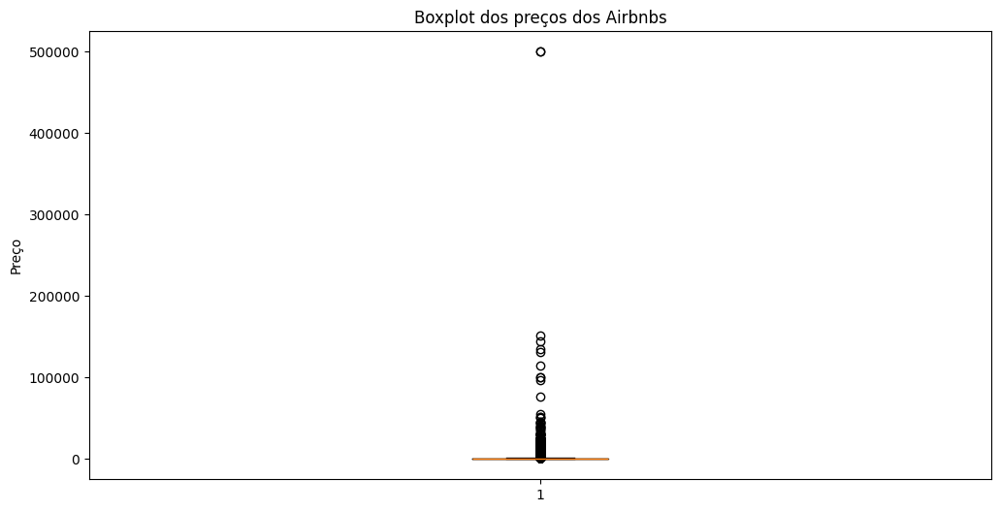

In [73]:
# Boxplot dos preços dos Airbnbs
plt.figure(figsize=(12, 6))
plt.boxplot(df['price'].dropna(), vert=True)
plt.title("Boxplot dos preços dos Airbnbs")
plt.ylabel("Preço")
plt.show()

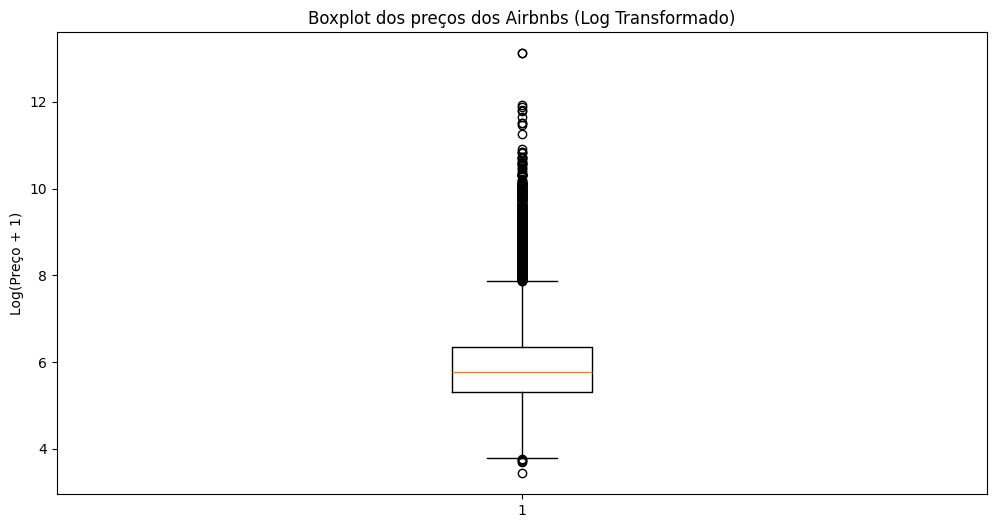

In [74]:
# Boxplot dos preços dos Airbnbs (Log Transformado)
df['price_log'] = np.log1p(df['price']) 
plt.figure(figsize=(12, 6))
plt.boxplot(df['price_log'].dropna(), vert=True)
plt.title("Boxplot dos preços dos Airbnbs (Log Transformado)")
plt.ylabel("Log(Preço + 1)")
plt.show()

In [75]:
# Ajudar a visualizar melhor a distribuição dos preços, removendo outliers extremos
df_filtered = df[df["price"] < 2000]

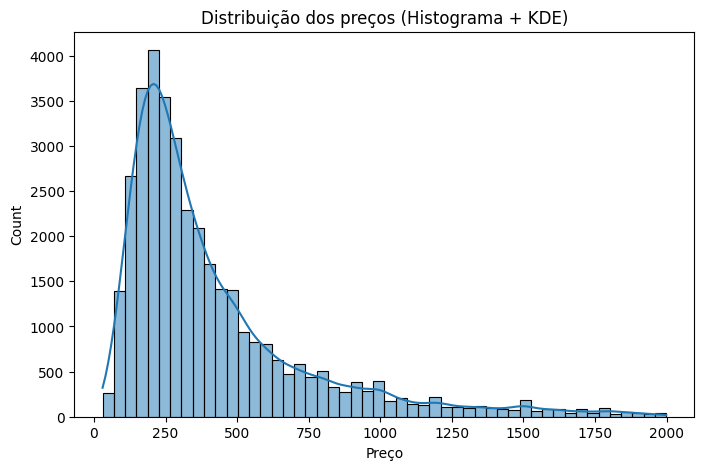

In [76]:
# Histograma dos preços com KDE
plt.figure(figsize=(8,5))
sns.histplot(df_filtered["price"], bins=50, kde=True)
plt.xlabel("Preço")
plt.title("Distribuição dos preços (Histograma + KDE)")
plt.show()


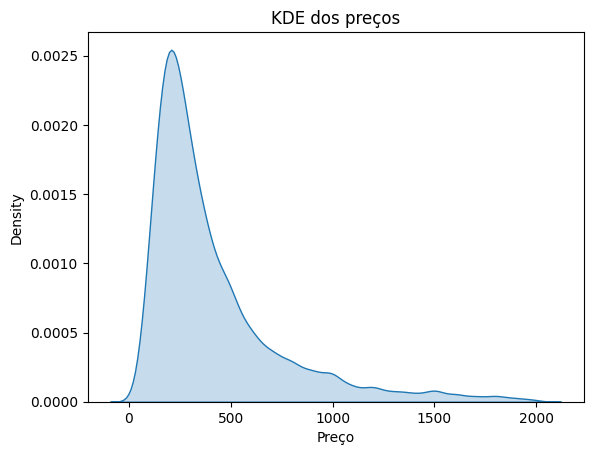

In [77]:
# Somente KDE dos preços
sns.kdeplot(df_filtered["price"].dropna(), fill=True)
plt.xlabel("Preço")
plt.title("KDE dos preços")
plt.show()


/tmp/ipykernel_231052/602020577.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df_filtered, x="room_type", y="price", palette="viridis")


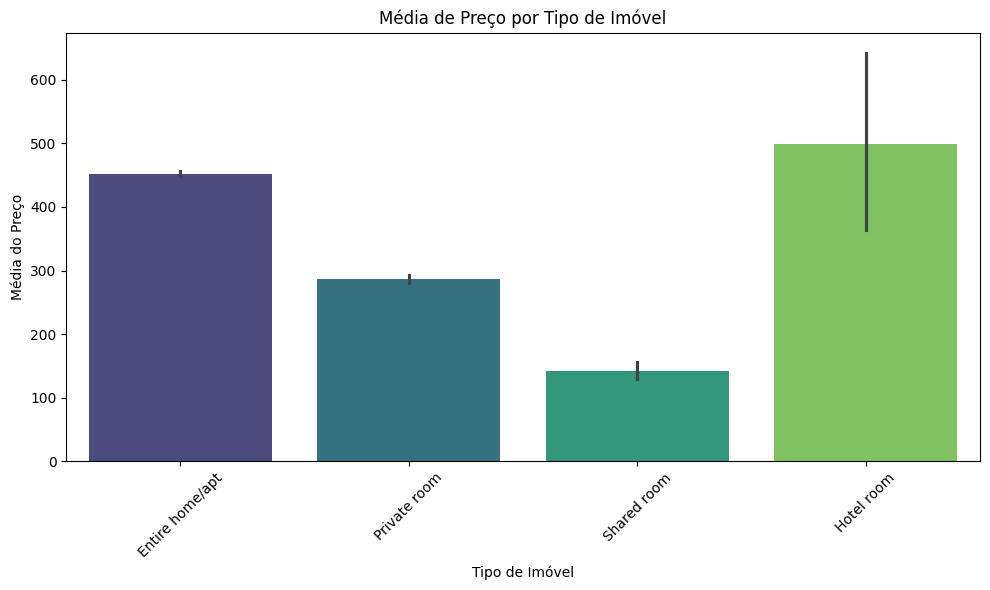

In [78]:
# Média de preço por tipo de imóvel
plt.figure(figsize=(10,6))
sns.barplot(data=df_filtered, x="room_type", y="price", palette="viridis")

plt.title("Média de Preço por Tipo de Imóvel")
plt.xlabel("Tipo de Imóvel")
plt.ylabel("Média do Preço")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

/tmp/ipykernel_231052/290994840.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df_filtered, x="room_type", y="price", palette="viridis")


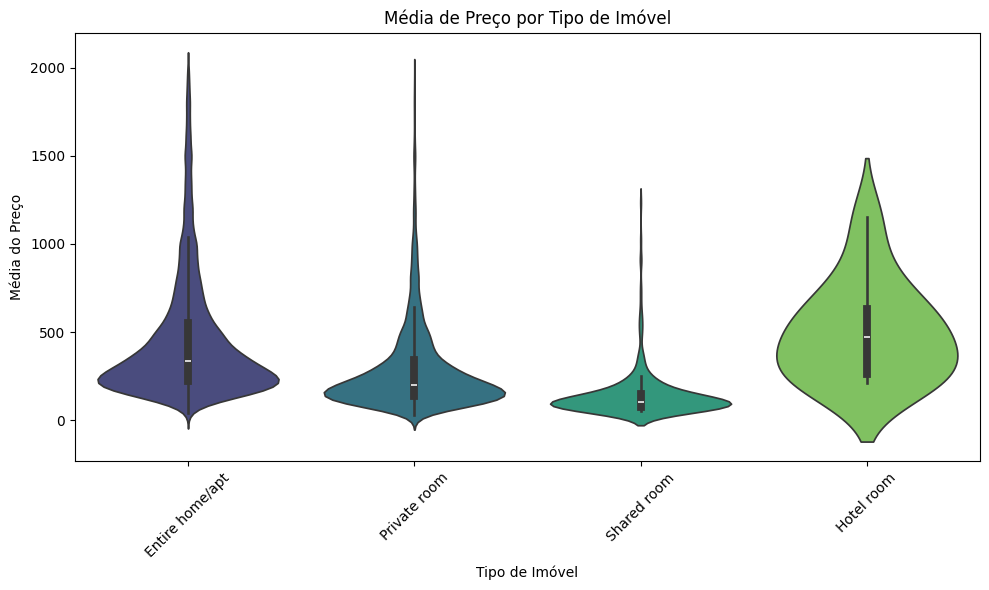

In [79]:
# Média de preço por tipo de imóvel
plt.figure(figsize=(10,6))
sns.violinplot(data=df_filtered, x="room_type", y="price", palette="viridis")

plt.title("Média de Preço por Tipo de Imóvel")
plt.xlabel("Tipo de Imóvel")
plt.ylabel("Média do Preço")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

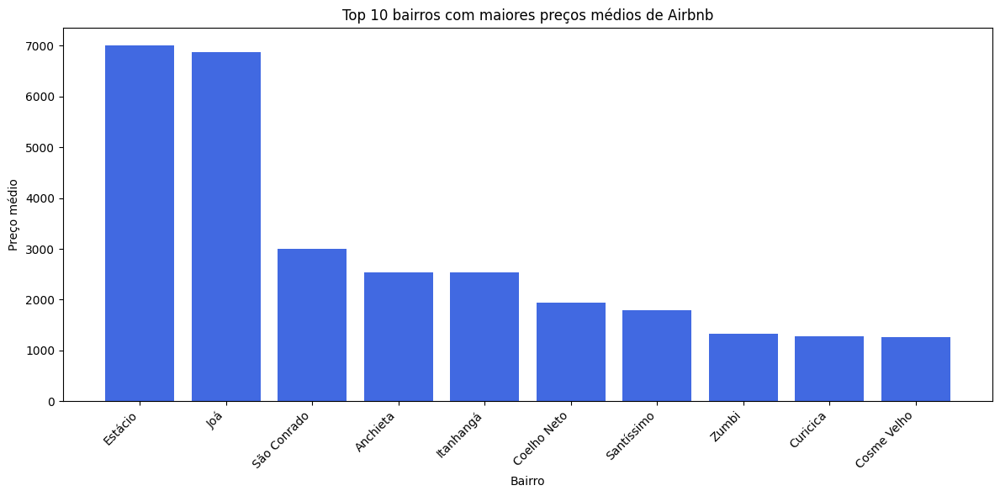

In [80]:
# Média de preço por bairro
mean = df.groupby('neighbourhood_cleansed')['price'].mean().sort_values(ascending=False).reset_index()

# Calcular média de preço por bairro
mean_price_per_neighbourhood = df.groupby("neighbourhood_cleansed")["price"].mean().reset_index()

# Selecionar top 10 bairros mais caros
top_neighbourhoods = mean_price_per_neighbourhood.sort_values(by="price", ascending=False).head(10)

# Criar gráfico de barras
plt.figure(figsize=(12, 6))
plt.bar(top_neighbourhoods["neighbourhood_cleansed"], top_neighbourhoods["price"], color="royalblue")
plt.xticks(rotation=45, ha="right")
plt.ylabel("Preço médio")
plt.xlabel("Bairro")
plt.title("Top 10 bairros com maiores preços médios de Airbnb")
plt.tight_layout()
plt.show()

In [81]:
valid_neighbourhoods = df['neighbourhood_cleansed'].value_counts()
valid_neighbourhoods = valid_neighbourhoods[valid_neighbourhoods > 100].index

df_filtered_neighbourhood = df[df['neighbourhood_cleansed'].isin(valid_neighbourhoods)]

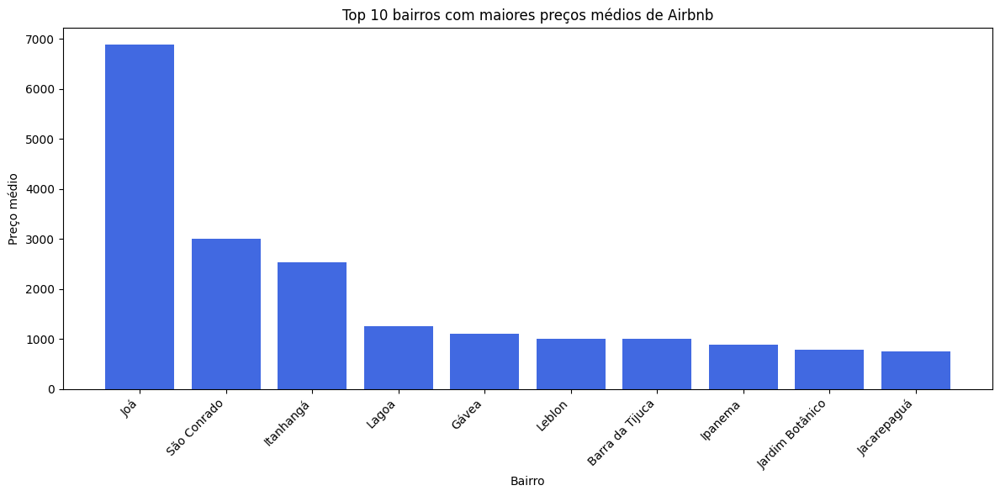

In [82]:
# Bairros com airbnb mais caros, com mais de 100 anúncios
mean = df_filtered_neighbourhood.groupby('neighbourhood_cleansed')['price'].mean().sort_values(ascending=False).reset_index()

# Calcular média de preço por bairro
mean_price_per_neighbourhood = df_filtered_neighbourhood.groupby("neighbourhood_cleansed")["price"].mean().reset_index()

# Selecionar top 10 bairros mais caros
top_neighbourhoods = mean_price_per_neighbourhood.sort_values(by="price", ascending=False).head(10)

# Criar gráfico de barras
plt.figure(figsize=(12, 6))
plt.bar(top_neighbourhoods["neighbourhood_cleansed"], top_neighbourhoods["price"], color="royalblue")
plt.xticks(rotation=45, ha="right")
plt.ylabel("Preço médio")
plt.xlabel("Bairro")
plt.title("Top 10 bairros com maiores preços médios de Airbnb")
plt.tight_layout()
plt.show()

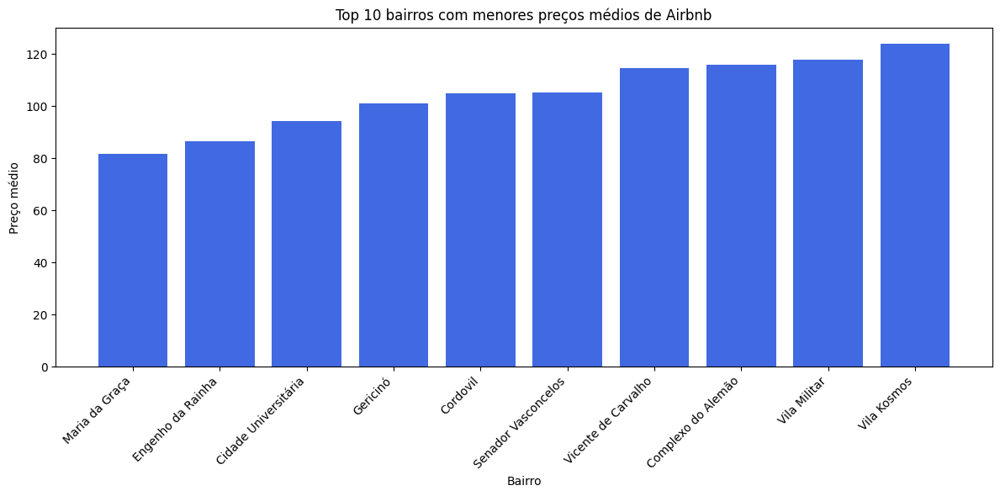

In [83]:
# Bairros com airbnb mais baratos
mean = df.groupby('neighbourhood_cleansed')['price'].mean().sort_values(ascending=False).reset_index()

# Calcular média de preço por bairro
mean_price_per_neighbourhood = df.groupby("neighbourhood_cleansed")["price"].mean().reset_index()

# Selecionar top 10 bairros mais baratos
top_cheap_neighbourhoods = mean_price_per_neighbourhood.sort_values(by="price", ascending=True).head(10)

# Criar gráfico de barras
plt.figure(figsize=(12, 6))
plt.bar(top_cheap_neighbourhoods["neighbourhood_cleansed"], top_cheap_neighbourhoods["price"], color="royalblue")
plt.xticks(rotation=45, ha="right")
plt.ylabel("Preço médio")
plt.xlabel("Bairro")
plt.title("Top 10 bairros com menores preços médios de Airbnb")
plt.tight_layout()
plt.show()

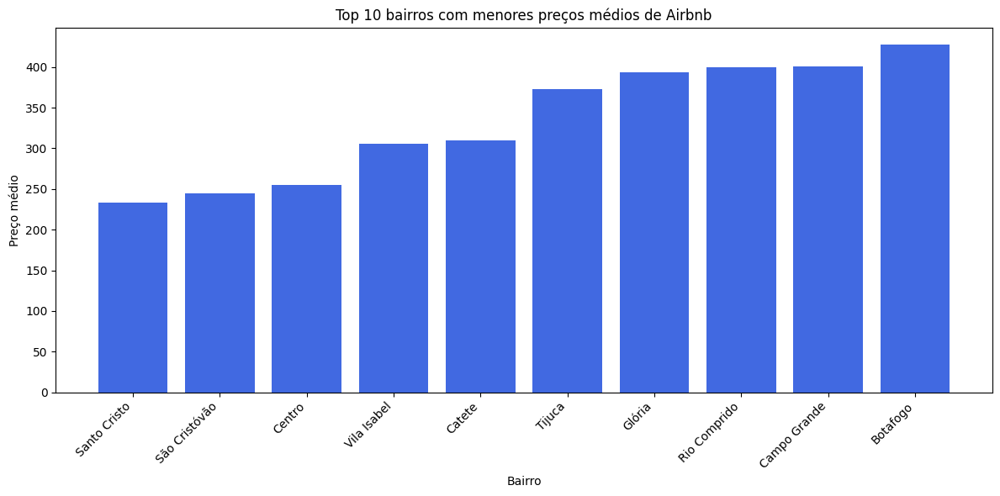

In [84]:
# Bairros com airbnb mais baratos, com mais de 100 anúncios 
mean = df_filtered_neighbourhood.groupby('neighbourhood_cleansed')['price'].mean().sort_values(ascending=False).reset_index()

# Calcular média de preço por bairro
mean_price_per_neighbourhood = df_filtered_neighbourhood.groupby("neighbourhood_cleansed")["price"].mean().reset_index()

# Selecionar top 10 bairros mais baratos
top_cheap_neighbourhoods = mean_price_per_neighbourhood.sort_values(by="price", ascending=True).head(10)

# Criar gráfico de barras
plt.figure(figsize=(12, 6))
plt.bar(top_cheap_neighbourhoods["neighbourhood_cleansed"], top_cheap_neighbourhoods["price"], color="royalblue")
plt.xticks(rotation=45, ha="right")
plt.ylabel("Preço médio")
plt.xlabel("Bairro")
plt.title("Top 10 bairros com menores preços médios de Airbnb")
plt.tight_layout()
plt.show()

<Axes: xlabel='host_is_superhost', ylabel='price'>

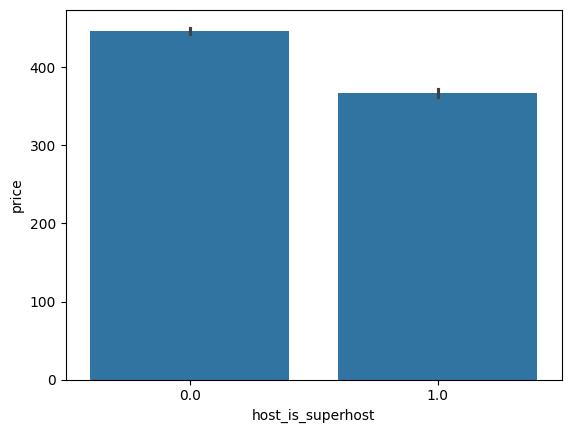

In [85]:
# Tentando ver se há relação entre ser superhost e o preço médio dos anúncios (aparentemente não há)
sns.barplot(data=df_filtered, x="host_is_superhost", y="price", estimator="mean")


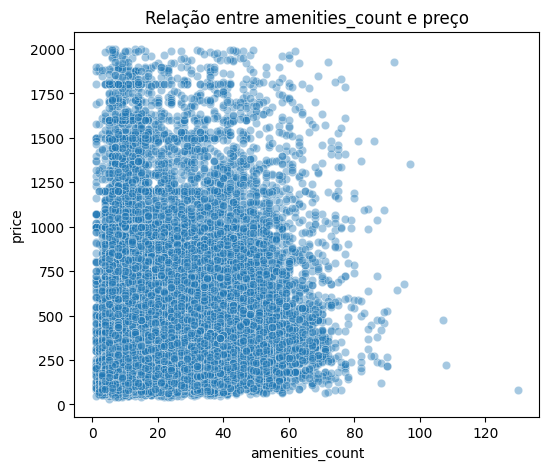

In [86]:
# Relação entre preço e quantidade de comodidades

plt.figure(figsize=(6,5))
sns.scatterplot(data=df_filtered, x="amenities_count", y="price", alpha=0.4)
plt.title("Relação entre amenities_count e preço")
plt.show()


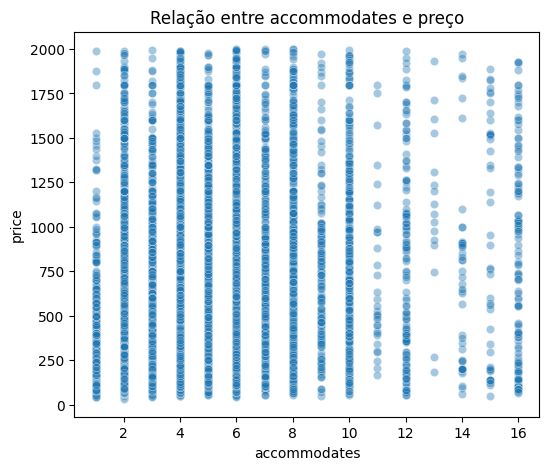

In [87]:
# quantidade de hospedes e preço
plt.figure(figsize=(6,5))
sns.scatterplot(data=df_filtered, x="accommodates", y="price", alpha=0.4)
plt.title("Relação entre accommodates e preço")
plt.show()

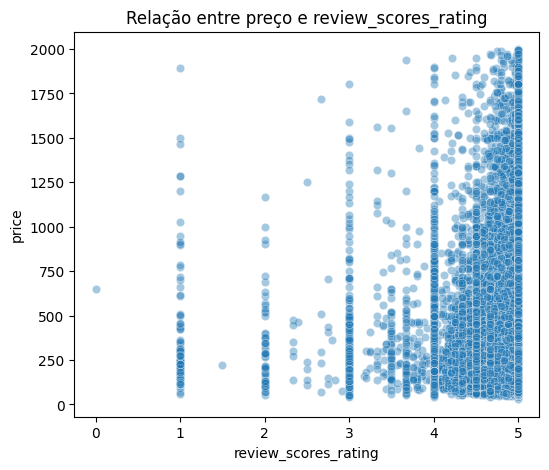

In [88]:
# Tentando ver se há relação entre review_scores_rating e preço
plt.figure(figsize=(6,5))
sns.scatterplot(data=df_filtered, x="review_scores_rating", y="price", alpha=0.4)
plt.title("Relação entre preço e review_scores_rating")
plt.show()

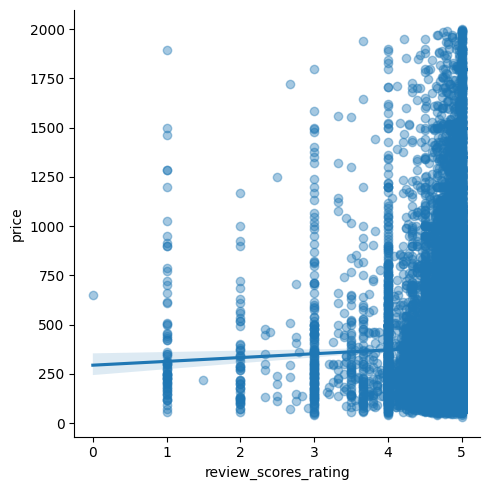

In [89]:
# Regressão entre review_scores_rating e preço
sns.lmplot(data=df_filtered, x="review_scores_rating", y="price", height=5, scatter_kws={"alpha":0.4})


In [90]:
numerical_features = df[features_to_use].select_dtypes(include=[int, float]).columns.tolist()


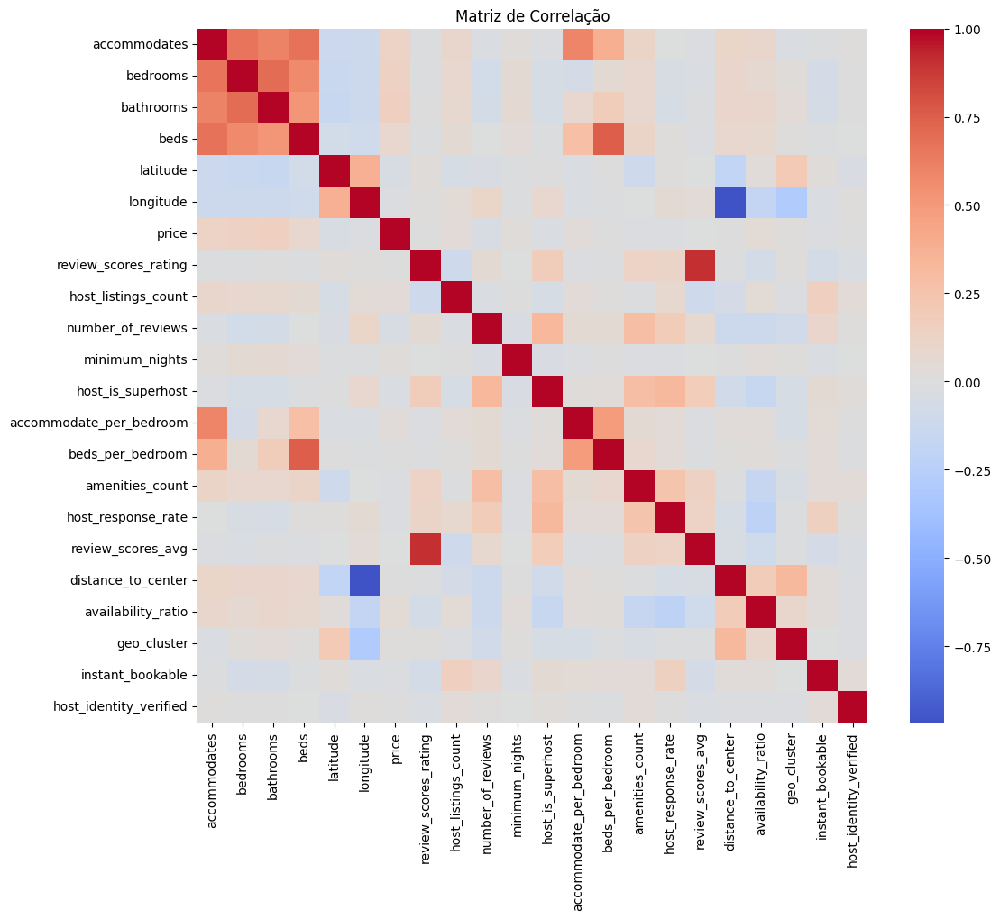

In [91]:
# Matriz de correlação
corr = df[numerical_features].corr()

plt.figure(figsize=(12, 10))
sns.heatmap(corr, annot=False, cmap='coolwarm', center=0)
plt.title("Matriz de Correlação")
plt.show()

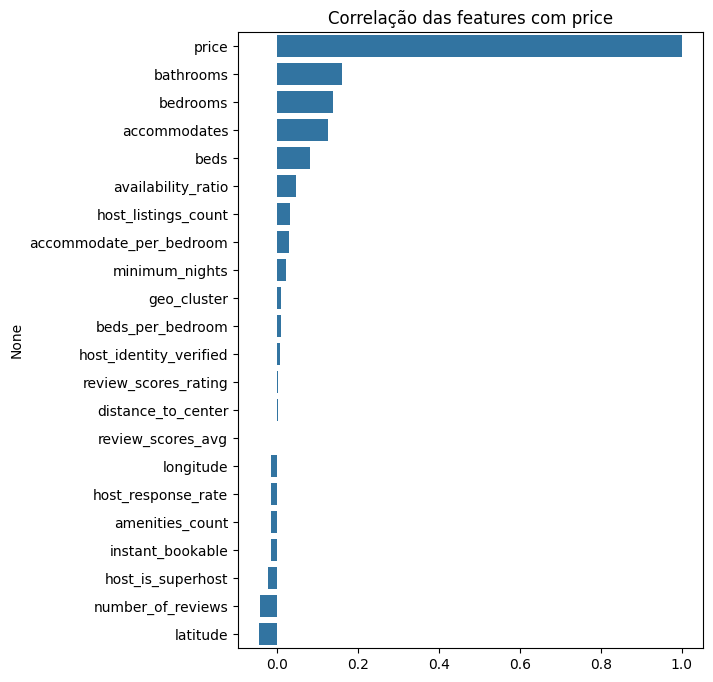

In [92]:
# Correlação das features com preço
corr_price = corr["price"].sort_values(ascending=False)
corr_price
plt.figure(figsize=(6, 8))
sns.barplot(x=corr_price.values, y=corr_price.index)
plt.title("Correlação das features com price")
plt.show()


<Axes: xlabel='host_identity_verified', ylabel='price'>

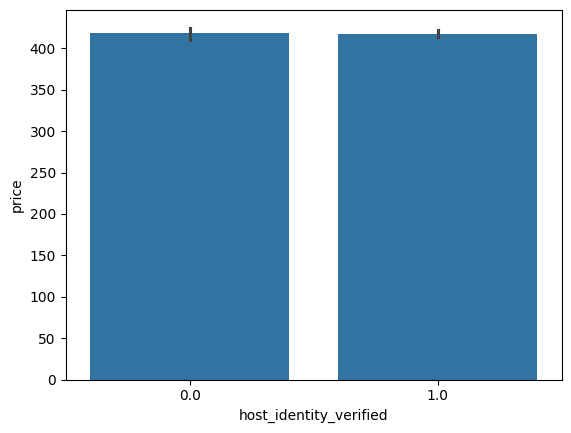

In [93]:
# Tentando ver se há relação entre ter identidade verificada e o preço médio dos anúncios (aparentemente não há)
sns.barplot(data=df_filtered, x="host_identity_verified", y="price", estimator="mean")


In [94]:
# Garantir features únicas antes de criar df_cleaned
features_to_use = list(dict.fromkeys(features_to_use))
df_cleaned = df[features_to_use].dropna()

In [95]:
df_cleaned.shape

(27828, 24)

### Traçando gráficos geográficos utilizando Folium

In [96]:
import folium
from folium.plugins import HeatMap
import branca.colormap as cm
from folium.plugins import MarkerCluster

In [97]:
center_lat = df_cleaned["latitude"].mean()
center_lon = df_cleaned["longitude"].mean()

Para visualizar os mapas interativos, clone o repositório e abra os notebooks no Jupyter Notebook, descomente as variaveis `m` e execute. Infelizmente não é possível visualizar pelo github devido o tamanho dos arquivos.

In [98]:
# Mapa de calor dos preços dos Airbnbs
m = folium.Map(location=[center_lat, center_lon], zoom_start=12)

heat_data = df_cleaned[["latitude", "longitude", "price"]].values.tolist()

HeatMap(heat_data, radius=12, max_zoom=13).add_to(m)

# m


In [99]:
# Mapa de calor da densidade dos Airbnbs
m = folium.Map(location=[center_lat, center_lon], zoom_start=12)

heat_data = df_cleaned[["latitude", "longitude"]].values.tolist()
HeatMap(heat_data, radius=12).add_to(m)

# m


In [ ]:
# Mapa interativo com marcadores agrupados
m = folium.Map(location=[center_lat, center_lon], zoom_start=12)

cluster = MarkerCluster().add_to(m)

for _, row in df_cleaned.iterrows():
    folium.Marker(
        location=[row["latitude"], row["longitude"]],
        popup=f"{row['room_type']} - R${row['price']} - {row['neighbourhood_cleansed']} - {row['accommodates']} Hóspedes"
    ).add_to(cluster)

m

In [101]:
# Mapa com marcadores coloridos por tipo de quarto

color_map = {
    "Entire home/apt": "blue",
    "Private room": "green",
    "Shared room": "red",
    "Hotel room": "purple"
}

center_lat = df["latitude"].mean()
center_lon = df["longitude"].mean()

m = folium.Map(location=[center_lat, center_lon], zoom_start=12)

for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row["latitude"], row["longitude"]],
        radius=3,
        color=color_map.get(row["room_type"], "gray"),
        fill=True,
        fill_opacity=0.5,
    ).add_to(m)

legend_html = """
<div style="position: fixed; 
     bottom: 50px; left: 50px; width: 150px; 
     background-color: white; z-index: 9999; padding: 10px;
     border: 2px solid black;">
<strong>Room Type</strong><br>
<span style="color: blue">●</span> Entire home/apt<br>
<span style="color: green">●</span> Private room<br>
<span style="color: red">●</span> Shared room<br>
<span style="color: purple">●</span> Hotel room<br>
</div>
"""

m.get_root().html.add_child(folium.Element(legend_html))

# m


In [102]:
# Mapa de calor da densidade dos Airbnbs
m = folium.Map(location=[center_lat, center_lon], zoom_start=12, tiles='CartoDB positron')

heat_data = df_cleaned[["latitude", "longitude"]].values.tolist()
HeatMap(heat_data, radius=12).add_to(m)

# m


### 4. Regressão para predição de preços

In [103]:
df_cleaned.isnull().sum()

accommodates               0
bedrooms                   0
bathrooms                  0
beds                       0
neighbourhood_cleansed     0
latitude                   0
longitude                  0
price                      0
review_scores_rating       0
room_type                  0
host_listings_count        0
number_of_reviews          0
minimum_nights             0
host_is_superhost          0
accommodate_per_bedroom    0
beds_per_bedroom           0
amenities_count            0
host_response_rate         0
review_scores_avg          0
distance_to_center         0
availability_ratio         0
geo_cluster                0
instant_bookable           0
host_identity_verified     0
dtype: int64

In [104]:
df_cleaned.shape

(27828, 24)

In [105]:
df_cleaned['price_log'] = np.log1p(df_cleaned['price'])
numerical_features.remove('price')
numerical_features.append('price_log')

In [106]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np
from xgboost import XGBRegressor
from sklearn.tree import DecisionTreeRegressor

In [107]:
def evaluate_model(name, y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    r2 = r2_score(y_true, y_pred)
    print(f"\n{name} Evaluation:")
    print(f"MAE : {mae:.4f}")
    print(f"RMSE: {rmse:.4f}")
    print(f"R²  : {r2:.4f}")
    return {'name': name, 'MAE': mae, 'RMSE': rmse, 'R2': r2}

In [108]:
categorical_features = ['neighbourhood_cleansed', 'room_type']
target = 'price_log'

# Definir features numéricas explicitamente para evitar duplicatas
numerical_features_clean = [
    'accommodates',
    'bedrooms',
    'bathrooms',
    'beds',
    'latitude',
    'longitude',
    'review_scores_rating',
    'host_listings_count',
    'number_of_reviews',
    'minimum_nights',
    'accommodate_per_bedroom',
    'beds_per_bedroom',
    'amenities_count',
    'host_response_rate',
    'review_scores_avg',
    'distance_to_center',
    'availability_ratio',
    'geo_cluster',
    'host_is_superhost',
    'instant_bookable',
    'host_identity_verified',
]

print(f"Numerical features ({len(numerical_features_clean)}): {numerical_features_clean}")

X = df_cleaned[numerical_features_clean + categorical_features]
y = df_cleaned[target]

# Verificar se há colunas duplicadas
print(f"\nColunas duplicadas em X: {X.columns[X.columns.duplicated()].tolist()}")

preprocess = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_features),
        ('num', StandardScaler(), numerical_features_clean)
    ])

Numerical features (21): ['accommodates', 'bedrooms', 'bathrooms', 'beds', 'latitude', 'longitude', 'review_scores_rating', 'host_listings_count', 'number_of_reviews', 'minimum_nights', 'accommodate_per_bedroom', 'beds_per_bedroom', 'amenities_count', 'host_response_rate', 'review_scores_avg', 'distance_to_center', 'availability_ratio', 'geo_cluster', 'host_is_superhost', 'instant_bookable', 'host_identity_verified']

Colunas duplicadas em X: []


In [109]:
# arvore de decisão com regularização
dt_model = Pipeline(steps=[
    ('preprocess', preprocess),
    ('regressor', DecisionTreeRegressor(
        max_depth=15, 
        min_samples_split=10,
        min_samples_leaf=5,
        random_state=42
    ))
])

# XGBoost
xgb_model = Pipeline(steps=[
    ('preprocess', preprocess),
    ('regressor', XGBRegressor(
        n_estimators=700,
        learning_rate=0.03,
        max_depth=10,
        subsample=0.8,
        colsample_bytree=0.8,
        min_child_weight=3,
        reg_alpha=0.1,
        reg_lambda=1.0,
        objective='reg:squarederror',
        random_state=42,
        n_jobs=-1
    ))
])

# Ridge
ridge_model = Pipeline(steps=[
    ('preprocess', preprocess),
    ('regressor', Ridge(alpha=1.0))
])

# Random Forest 
rf_model = Pipeline(steps=[
    ('preprocess', preprocess),
    ('regressor', RandomForestRegressor(
        n_estimators=500,
        max_depth=25,
        min_samples_split=5,
        min_samples_leaf=2,
        max_features="sqrt",
        random_state=42,
        n_jobs=-1
    ))
])


# Gradient Boosting
gb_model = Pipeline(steps=[
    ('preprocess', preprocess),
    ('regressor', GradientBoostingRegressor(
        n_estimators=300,
        learning_rate=0.05,
        max_depth=8,
        min_samples_split=5,
        min_samples_leaf=3,
        subsample=0.8,
        random_state=42
    ))
])


# Removendo os 1% valores mais baixos e 1% mais altos utilizando IQR
Q1 = y.quantile(0.01)
Q99 = y.quantile(0.99)
mask = (y >= Q1) & (y <= Q99)

X = X[mask]
y = y[mask]


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

ridge_model.fit(X_train, y_train)
rf_model.fit(X_train, y_train)
dt_model.fit(X_train, y_train)
xgb_model.fit(X_train, y_train)
gb_model.fit(X_train, y_train)


y_pred_ridge = ridge_model.predict(X_test)
y_pred_rf = rf_model.predict(X_test)
y_pred_dt = dt_model.predict(X_test)
y_pred_xgb = xgb_model.predict(X_test)
y_pred_gb = gb_model.predict(X_test)

results = []
results.append(evaluate_model("Ridge Regression", y_test, y_pred_ridge))
results.append(evaluate_model("Random Forest Regressor", y_test, y_pred_rf))
results.append(evaluate_model("Decision Tree Regressor", y_test, y_pred_dt))
results.append(evaluate_model("XGBoost Regressor", y_test, y_pred_xgb))
results.append(evaluate_model("Gradient Boosting", y_test, y_pred_gb))

best_model = max(results, key=lambda x: x['R2'])
print(f"\nMelhor modelo: {best_model['name']} with R² = {best_model['R2']:.4f}")



Ridge Regression Evaluation:
MAE : 0.3432
RMSE: 0.4708
R²  : 0.5189

Random Forest Regressor Evaluation:
MAE : 0.3149
RMSE: 0.4231
R²  : 0.6116

Decision Tree Regressor Evaluation:
MAE : 0.3611
RMSE: 0.4877
R²  : 0.4839

XGBoost Regressor Evaluation:
MAE : 0.2861
RMSE: 0.3897
R²  : 0.6705

Gradient Boosting Evaluation:
MAE : 0.2902
RMSE: 0.3933
R²  : 0.6644

Melhor modelo: XGBoost Regressor with R² = 0.6705


In [110]:
categorical_features

['neighbourhood_cleansed', 'room_type']

In [111]:
numerical_features

['accommodates',
 'bedrooms',
 'bathrooms',
 'beds',
 'latitude',
 'longitude',
 'review_scores_rating',
 'host_listings_count',
 'number_of_reviews',
 'minimum_nights',
 'host_is_superhost',
 'accommodate_per_bedroom',
 'beds_per_bedroom',
 'amenities_count',
 'host_response_rate',
 'review_scores_avg',
 'distance_to_center',
 'availability_ratio',
 'geo_cluster',
 'instant_bookable',
 'host_identity_verified',
 'price_log']

### 5. Save model

In [112]:
import joblib
from pathlib import Path

model_dir = Path('models/')
model_dir.mkdir(exist_ok=True)

joblib.dump(xgb_model, model_dir / "xgboost_pipeline.joblib")
print("Pipeline XGBoost salvo como 'xgboost_pipeline.joblib'")

import json
model_metadata = {
    'numerical_features': numerical_features_clean,
    'categorical_features': categorical_features,
    'target': 'price_log'
}
with open(model_dir / "model_metadata.json", "w") as f:
    json.dump(model_metadata, f, indent=2)
print("Metadata salvo como 'model_metadata.json'")

Pipeline XGBoost salvo como 'xgboost_pipeline.joblib'
Metadata salvo como 'model_metadata.json'
